Here I choose patches / features from 50 images, and find random patches that are contained in each centile. Each row corresponds to 10 images taken from each centile

In [1]:
import os
import sys
sys.path = ['/nfs/gns/homes/willj/anaconda3/envs/GTEx/lib/python3.5/site-packages'] + sys.path
GTEx_directory = '/hps/nobackup/research/stegle/users/willj/GTEx'
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import scipy
import h5py

def get_patches_in_percentile_range(percentile_range,patches,feature_vector):

    """Return the patches with in a given percentile range"""
    
    percentile_top = percentile_range[1]
    percentile_bottom = percentile_range[0]
    
    top_limit = np.percentile(feature_vector,percentile_top)
    bottom_limit = np.percentile(feature_vector,percentile_bottom)
    bool_idx = np.bitwise_and(feature_vector >= bottom_limit, feature_vector <= top_limit)
    idx = list(np.squeeze(np.argwhere(bool_idx)))
    patches_in_percentile = [all_patches[i] for i in idx]
    features_in_percentile = feature_vector[np.bitwise_and(feature_vector >= bottom_limit, feature_vector <= top_limit)]
    return patches_in_percentile, features_in_percentile

tissue = 'Lung'
patch_size = 256
feature = 783

tissue_filepath = os.path.join(GTEx_directory,'data','raw',tissue)
tissue_images = os.listdir(tissue_filepath)
all_tissue_IDs = [x.split('.')[0] for x in tissue_images]

with h5py.File(GTEx_directory + '/data/retrained_inceptionet_features.hdf5','r') as f:
    filt_tissue_IDs = list(f['lung']['features']['512'].keys())

all_patches = []
all_features = []
for ID in np.random.choice(filt_tissue_IDs,20):
    print (ID)
    
    with h5py.File(GTEx_directory + '/data/better_covering_patches/{}_{}.hdf5'.format(ID,patch_size),'r') as f:
        patches = list(f['patches'].value)
        all_patches.extend(patches)

    with h5py.File(GTEx_directory + '/data/retrained_inceptionet_features.hdf5','r') as f:
        features = list(f['lung']['features'][str(patch_size)][ID].value)
        all_features.extend(features)

all_features = np.array(all_features)
# all_patches = np.array(all_patches)

GTEX-11DXZ-0726
GTEX-OIZI-1026
GTEX-RM2N-0426
GTEX-11P7K-0326
GTEX-YECK-0926
GTEX-13FH7-1726
GTEX-13N1W-0726
GTEX-11UD2-0726
GTEX-13O3O-0726
GTEX-13VXU-2726
GTEX-13FTX-0326
GTEX-ZVT3-0926
GTEX-11EI6-0826
GTEX-11PRG-0926
GTEX-S7SE-0926
GTEX-OHPL-0526
GTEX-Y8E4-0526
GTEX-Y5V5-0826
GTEX-WOFM-0126
GTEX-ZZPU-0526


In [2]:
print (len(all_features))

97097


[ 3152 66436 13158 19796 64510  8052 18859 30877 52774 13576]
[49400 50175 24949 40928 29380 58171 41938 68051 46832 34323]
[38322 57893 39321 16440 43698  3654 64338 34290 31286 46744]
[28335 22991  3049 51763 14136 37220 46058 37827 37789 26310]
[34282 56800  5884  9113 57598 16551 28185 51802  2876 59219]
[68024 22842 61521 40685 59718 65780  9451 62973 14931 24827]
[20016 43842 49321  3711 57149 44600 15821 13574 48853 25740]
[26128 55293 72312 35204 65769 53501 72231 46790 54674 62913]
[5790 2637 1271 3097  909 3807 6670  376 6019 4424]
[1201 2318  706 6895 2488 5605 2343 7947  580 6840]


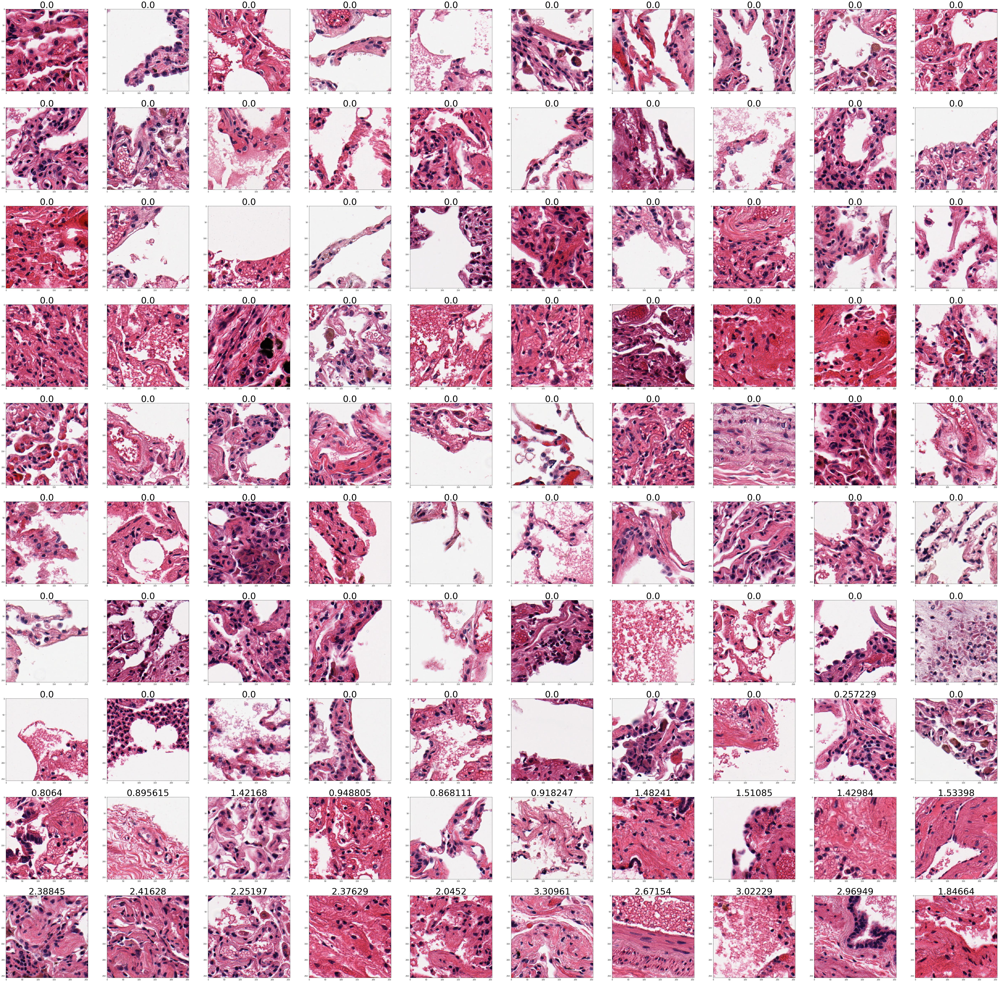

In [3]:
feature_vector = all_features[:,feature]
f, a = plt.subplots(10,10, figsize=(100,100))
for i in range(0,10):
    percentile_range = [10*i,10*(i+1)]
    patches_in_percentile, features_in_percentile = get_patches_in_percentile_range(percentile_range,all_patches,feature_vector)
    random_idx_in_percentile = np.random.choice(range(len(patches_in_percentile)),10)
    print (random_idx_in_percentile)
    random_images_in_percentile = [patches_in_percentile[k] for k in random_idx_in_percentile]
    random_features_in_percentile = features_in_percentile[random_idx_in_percentile]
    for j in range(10):
        a[i][j].imshow(random_images_in_percentile[j])
        a[i][j].set_title(random_features_in_percentile[j], size=50)